In [2]:
import cv2
import sqlite3
from matplotlib import pyplot as plt
import numpy as np
import plotly

from visualize_model import Model
from database import blob_to_array, pair_id_to_image_ids
import sys
import plotly.graph_objects as go
import seaborn as sns
import cv2

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


c:\Users\Marcos\AppData\Local\Programs\Python\Python39\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# 2. Analyze reconstructions using python
## 2.1. Run the notebook, using the Gerrard Hall reconstruction (0.5)
#### <span style='color:Green'> - Add the path to your reconstruction. Answer the questions at the end  </span>

In [3]:
# Add your path
reconstruction_path = "./gerrard_hall"
database_path = "./gerrard_hall/database.db"

#### Load an existing reconstruction and print its contents

In [4]:
model = Model()
model.read_model(reconstruction_path+'/dense/0/sparse', ext='.bin') # Should also work with .txt

In [5]:
images = model.images
cameras = model.cameras
points3D = model.points3D

In [6]:
print(f"Loaded {len(images)} images. This is the information available for one of them:")
print(images[1])
print(f"\nLoaded {len(cameras)} cameras. This is the information available for one of them:")
print(cameras[1])
print(f"\nLoaded {len(points3D)} 3D points. This is the information available for one of them:")
print(points3D[3])

Loaded 98 images. This is the information available for one of them:
Image(id=1, qvec=array([-0.13811062,  0.02063923,  0.96963866, -0.20074945]), tvec=array([0.95108052, 1.09099779, 4.43342338]), camera_id=1, name='IMG_2331.JPG', xys=array([[ 753.99201549,  470.21029586],
       [ 388.163468  , 1201.36986705],
       [1873.17932838, 1106.91526861],
       ...,
       [1957.99697127, 1394.72774466],
       [2195.31322709, 1402.17708623],
       [ 130.15895345,   -8.46432262]]), point3D_ids=array([-1, -1, -1, ..., -1, -1, -1]))

Loaded 1 cameras. This is the information available for one of them:
Camera(id=1, model='PINHOLE', width=2400, height=1561, params=array([1567.33302423, 1567.14335004, 1200.        ,  780.5       ]))

Loaded 70740 3D points. This is the information available for one of them:
Point3D(id=3, xyz=array([ 0.98566044, -0.55391346, -1.73137662]), rgb=array([159, 159, 155]), error=array(0.29835924), image_ids=array([63, 58]), point2D_idxs=array([ 8, 12]))


#### Load the database

In [7]:
db = sqlite3.connect(database_path)

In [8]:
keypoints = dict(
        (image_id, blob_to_array(data, np.float32, (-1, 2)))
        for image_id, data in db.execute(
            "SELECT image_id, data FROM keypoints"))

In [9]:
print(f"Loaded keypoints from {len(keypoints)} images. These are the {len(keypoints[1])} keypoints for one of them:")
print(keypoints[1])

Loaded keypoints from 100 images. These are the 32616 keypoints for one of them:
[[ 1.7292351e+03  1.1214077e+03]
 [ 3.9607193e+02  3.3253399e-14]
 [ 2.4758311e+02  6.4772351e+02]
 ...
 [ 3.2946848e+02  4.3962437e+01]
 [ 5.1605954e+00 -7.7937651e-16]
 [ 1.5406924e+00  4.6744633e+00]]


In [10]:
matches = dict()
count_no_data = 0
for pair_id, data in db.execute("SELECT pair_id, data FROM matches"):
    if data is None:
        count_no_data += 1
    else:
        matches[pair_id_to_image_ids(pair_id)] = blob_to_array(data, np.uint32, (-1, 2))
print(f"Loaded {len(matches)} matches. {count_no_data}/{len(matches)+count_no_data} matches contained no data")

Loaded 1868 matches. 3082/4950 matches contained no data


In [11]:
print("These are the matches between two images:")
print(matches[1,2])

These are the matches between two images:
[[    0     1]
 [    1     2]
 [    2     7]
 ...
 [10849 10839]
 [10858  6144]
 [10869 10876]]


#### Visualize the point cloud and cameras

In [11]:
model.create_window()
model.add_points()
model.add_cameras(scale=0.25)
model.show()

#### <span style='color:Green'>  How many keypoints there are in total? </span> 

In [12]:
total_keypoints = 0
for key in keypoints.keys():
    total_keypoints += len(keypoints[key])
    
print('There are a total of %d keypoints' %total_keypoints)

There are a total of 3112449 keypoints


#### <span style='color:Green'>  How many 3D points originated from a keypoint in the first image? </span>


In [13]:
# A keypoint in the first image
keypoint = keypoints[1]
keypoints_3Dpoint = np.zeros(len(keypoint))

# For each 3D point
for value in points3D.values():
    # If first image
    if 1 in value.image_ids:
        # Get keypoint index on list
        image_index = np.where(value.image_ids == 1)[0][0]
        keypoint_index = value.point2D_idxs[image_index]
        
        # This keypoint index is related to this 3D point
        keypoints_3Dpoint[keypoint_index] += 1
        
        
print('The number of 3D points originated from a keypoint in the first image: %d' % np.sum(keypoints_3Dpoint))

The number of 3D points originated from a keypoint in the first image: 3243


## 2.2 Plot the 3D points coloured according to the number of images and error. (0.5)

#### <span style='color:Green'> - Plot the 3D points coloured according to the **number of images** from which it originated. </span> Can you extract any conclusions from the visualization? 

In [14]:
points3d_x = []
points3d_y = []
points3d_z = []
points3d_c = []
points3d_error = []

# For each 3D point create the scatter3D values
for value in points3D.values():
    points3d_x.append(value.xyz[0])
    points3d_y.append(value.xyz[1])
    points3d_z.append(value.xyz[2])
    points3d_c.append(len(value.image_ids))
    points3d_error.append(value.error)


In [15]:
fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=1, 
                                       color=np.array(points3d_c),
                                       colorbar=dict(thickness=20)
                                       ))])
fig.show()

#### <span style='color:Green'> - Plot the 3D points coloured according to the **error**. </span> - What is this parameter? Can you extract any conclusions from the visualization?

In [16]:
fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=1, 
                                       color=np.array(points3d_error),
                                       colorbar=dict(thickness=20)
                                       ))])
fig.show()

## 2.3 Plot the 3D points that correspond to a keypoint in the first image. Also plot the image with the keypoints (1.0)


In [17]:
points3d_x = []
points3d_y = []
points3d_z = []

# For each 3D point
for value in points3D.values():
    # If first image
    if 1 in value.image_ids:
        points3d_x.append(value.xyz[0])
        points3d_y.append(value.xyz[1])
        points3d_z.append(value.xyz[2])

In [18]:
fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=1
                                       ))])
fig.show()

In [19]:
# Convert keypoints from images into a cv2 keypoint
keypoints_parsed = []

# Get all keypoints from first image
for kp in keypoints[1]:
    keypoints_parsed.append(cv2.KeyPoint(kp[0], kp[1], 50))

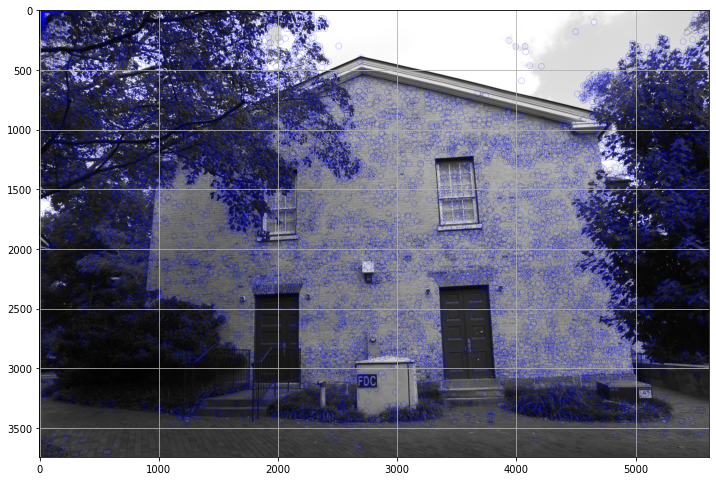

In [20]:
im_1 = cv2.imread('./gerrard_hall/images/IMG_2331.jpg')
im1_gray = cv2.cvtColor(im_1, cv2.COLOR_BGR2GRAY)
output_image = cv2.drawKeypoints(im1_gray, keypoints_parsed, 0, (0, 0, 255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.figure(figsize=(12,12))
plt.grid(b=None)
plt.imshow(output_image)
plt.show()
plt.close()

## 2.4 Create a visualization for the number of matches between all images. (1.0)
For example: https://seaborn.pydata.org/generated/seaborn.heatmap.html

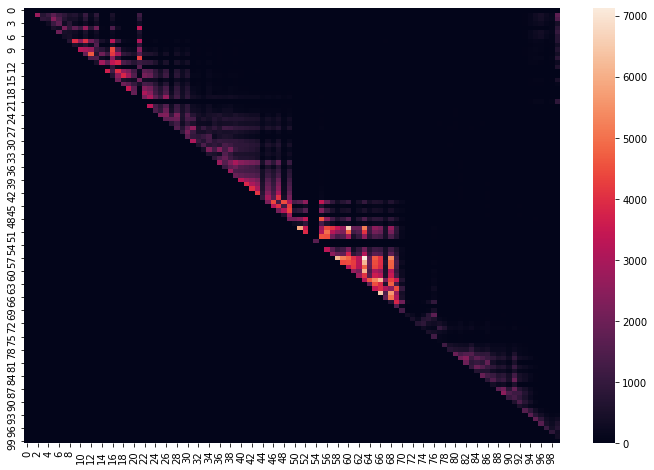

In [21]:
num_matches = np.zeros((100,100))

for i in range(1,101):
    for j in range(1,101):
        if i == j:
            continue
        try:
            num_matches[i,j] = matches[i,j].shape[0]
        except:
            pass

plt.figure(figsize=(12,8))
ax = sns.heatmap(num_matches)
plt.show()

Only matches between 1,2 are found, not the converse 2,1. There are more matches with the images that are more near in the index number.

## 2.5 Visualize the keypoints and matches between the two images used in lab 4 using Colmap, how it compares to the results from lab 4? (1.0)
#### <span style='color:Green'> You can use the GUI to get the keypoints and matches and then visualize it here, following the same style as in lab 4 to get comparable results. </span>

In [22]:
# Add your path
def read_model(path='lab4_images', show_model = False):
    reconstruction_path = "./"+path
    database_path = "./"+path+"/database.db"

    model = Model()
    model.read_model(reconstruction_path+'/dense/0/sparse', ext='.bin') # Should also work with .txt

    images = model.images
    cameras = model.cameras
    points3D = model.points3D

    db = sqlite3.connect(database_path)

    keypoints = dict(
        (image_id, blob_to_array(data, np.float32, (-1, cols)))
        for image_id, cols, data in db.execute(
            "SELECT image_id, cols, data FROM keypoints"))
    
    matches = dict()
    count_no_data = 0
    for pair_id, data in db.execute("SELECT pair_id, data FROM matches"):
        if data is None:
            count_no_data += 1
        else:
            matches[pair_id_to_image_ids(pair_id)] = blob_to_array(data, np.uint32, (-1, 2))
    print(f"Loaded {len(matches)} matches. {count_no_data}/{len(matches)+count_no_data} matches contained no data")

    if show_model:
        model.create_window()
        model.add_points()
        model.add_cameras(scale=0.25)
        model.show()
    
    return images, cameras, points3D, keypoints, matches

In [23]:
im_1 = cv2.imread('./lab4_images/images/0001_s.png')
im_2 = cv2.imread('./lab4_images/images/0002_s.png')

In [24]:
images, cameras, points3D, keypoints, matches = read_model('lab4_images')

Loaded 1 matches. 0/1 matches contained no data


In [25]:
# Convert keypoints from two images into a cv2 keypoint
keypoints_parsed = [[], []]

for im_index in keypoints:
    for kp in keypoints[im_index]:
        keypoints_parsed[im_index-1].append(cv2.KeyPoint(kp[0], kp[1], 1))
        
# Convert matches from two images into a cv2 match
matches_parsed = []
for index in matches.keys():
    match = matches[index]
    for correspondence in match:
        matches_parsed.append(cv2.DMatch(_queryIdx=correspondence[1], _trainIdx=correspondence[0], _distance=0))

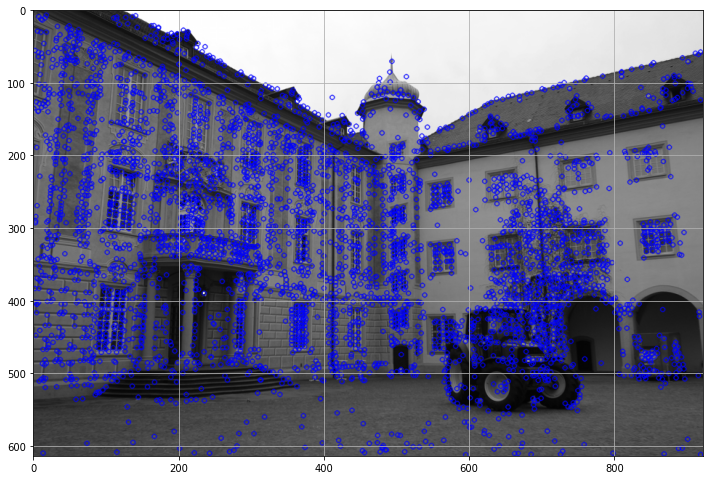

In [26]:
im1_gray = cv2.cvtColor(im_1, cv2.COLOR_BGR2GRAY)
output_image = cv2.drawKeypoints(im1_gray, keypoints_parsed[1], 0, (0, 0, 255))
plt.figure(figsize=(12,12))
plt.grid(b=None)
plt.imshow(output_image)
plt.show()

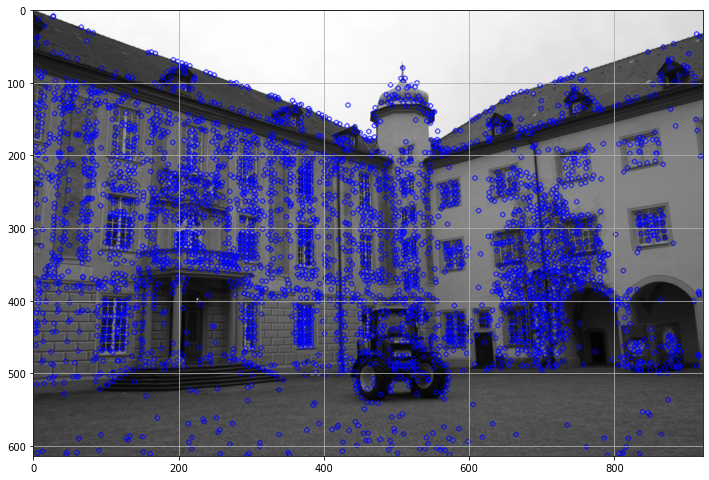

In [27]:
im2_gray = cv2.cvtColor(im_2, cv2.COLOR_BGR2GRAY)
output_image = cv2.drawKeypoints(im2_gray, keypoints_parsed[0], 0, (0, 0, 255))
plt.figure(figsize=(12,12))
plt.grid(b=None)
plt.imshow(output_image)
plt.show()

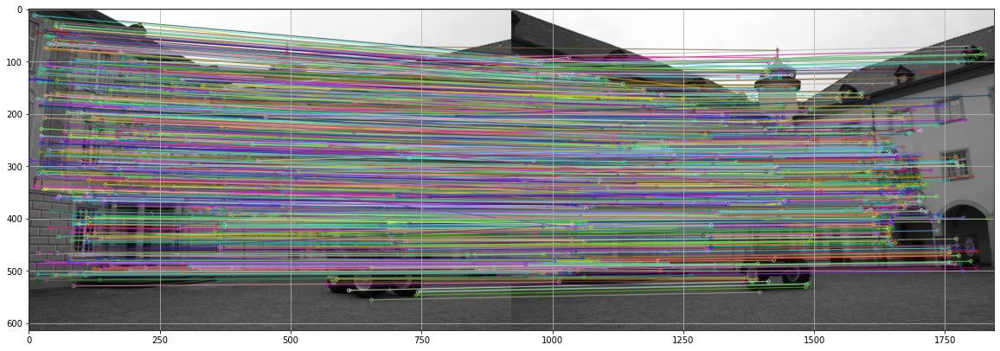

In [28]:
img_12 = cv2.drawMatches(im1_gray,keypoints_parsed[1],im2_gray,keypoints_parsed[0],matches_parsed,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.figure(figsize=(20,12))
plt.grid(b=None)
plt.imshow(img_12)
plt.show()

Selected keypoints on image 1

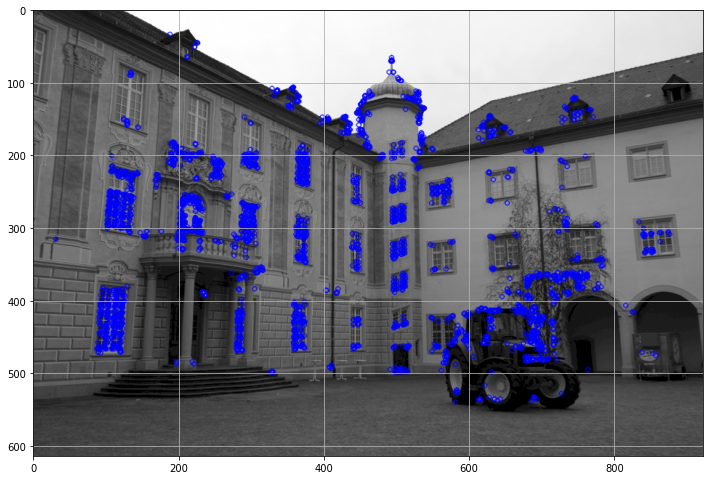

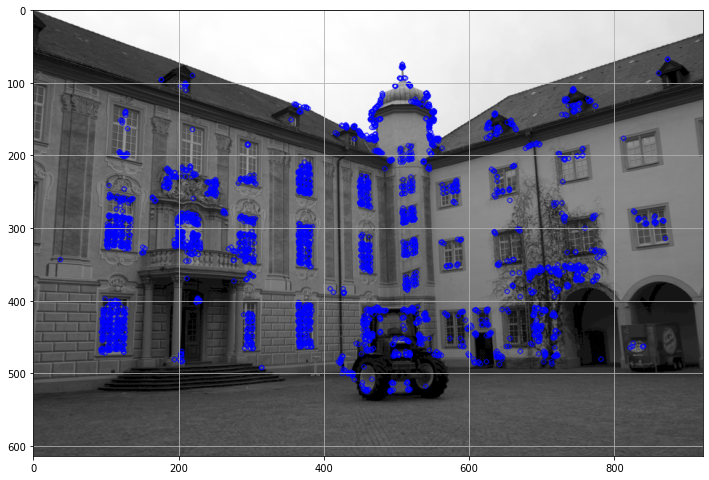

1733 615


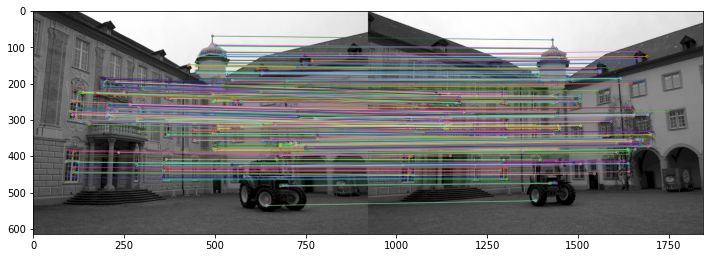

In [29]:
import aux_code as aux
from operator import itemgetter

# Read images
img1 = cv2.imread('./lab4_images/images/0001_s.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('./lab4_images/images/0002_s.png', cv2.IMREAD_GRAYSCALE)

h, w = img1.shape

# Initiate ORB detector
orb = cv2.ORB_create(3000)
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

output_image = cv2.drawKeypoints(img1, kp1, 0, (0, 0, 255))
plt.figure(figsize=(12,12))
plt.grid(b=None)
plt.imshow(output_image)
plt.show()

output_image = cv2.drawKeypoints(img2, kp2, 0, (0, 0, 255))
plt.figure(figsize=(12,12))
plt.grid(b=None)
plt.imshow(output_image)
plt.show()


# Keypoint matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
img_12 = cv2.drawMatches(img1,kp1,img2,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


# Robust estimation of the fundamental matrix #
points1 = []
points2 = []
for m in matches:
    points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
    points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])
    
points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

F, indices_inlier_matches = aux.Ransac_fundamental_matrix(points1, points2, 1, 5000)
inlier_matches = itemgetter(*indices_inlier_matches)(matches)

img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
fig = plt.figure(figsize=(12,12))
plt.imshow(img_12)
plt.show()

## 2.6 Triangulate and visualize the 3D points from the keypoints extracted using Colmap on the two images used in lab 4, how it compares to the results from lab 4? (1.0) 
#### <span style='color:Green'> - Use the triangulation from lab 4 to the get the 3D points and visualize them following the same style. </span>

In [30]:
def triangulate(x1, x2, P1, P2, imsize) -> np.ndarray:
    assert P1.shape == (3,4) == P2.shape
    assert x1.shape == x2.shape and x1.shape[0] == 3
    
    nx = imsize[0]
    ny = imsize[1]
    
    # Normalize
    x1 = x1 / x1[2,:]
    x2 = x2 / x2[2,:]
    
    # Construct H matrix
    H = [[2/nx,0,-1],
         [0,2/ny,-1],
         [0,0,1]]
    
    # We build A from ...
    x1 = H@x1
    x2 = H@x2
    P1 = H@P1
    P2 = H@P2
    
    X = np.zeros((4,x1.shape[1]))
    
    # We build different A's for each point
    for i in range(x1.shape[1]):
        x = x1[0,i]
        y = x1[1,i]
        x_prime = x2[0,i]
        y_prime = x2[1,i]
        A = [x*P1[2,:].T - P1[0,:].T, y*P1[2,:].T - P1[1,:].T, x_prime*P2[2,:].T - P2[0,:].T, y_prime*P2[2,:].T - P2[1,:].T]
        
        U,D,V = np.linalg.svd(A)
        V = V.T
        X[:,i] = V[:,-1] 
        
    
    return X

3226 573


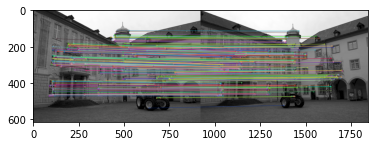

In [31]:
# Robust estimation of the fundamental matrix
points1 = []
points2 = []
for m in matches:
    points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
    points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])
    
points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

F, indices_inlier_matches = aux.Ransac_fundamental_matrix(points1, points2, 1, 5000)
inlier_matches = itemgetter(*indices_inlier_matches)(matches)

img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
fig = plt.figure()
plt.imshow(img_12)
plt.show()

In [32]:
# Camera calibration matrix
K = np.array([[2362.12, 0, 1520.69], [0, 2366.12, 1006.81], [0, 0, 1]])
scale = 0.3
H = np.array([[scale, 0, 0], [ 0, scale, 0], [0, 0, 1]])
K = H @ K

def essential_from_fundamental(K, F):
    E = K.T@F@K
    return E

E = essential_from_fundamental(K, F)

In [33]:
# # camera projection matrix for the first camera
# We use the camera calibration matrix
P1 = K @ np.hstack((np.identity((3)), np.zeros((1,3)).T))

# # four possible matrices for the second camera
Pc2 = [None, None, None, None]
W = np.array([[0,-1,0],
     [1,0,0],
     [0,0,1]])
U,D,V_T = np.linalg.svd(E) 

R1 = U@W@V_T
R2 = U@W.T@V_T

if np.linalg.det(R1) < 0:
     R1 = -R1
if np.linalg.det(R2) < 0:
     R2 = -R2
     
Pc2[0] = K @ np.hstack((R1, np.array([U[:,-1]]).T))
Pc2[1] = K @ np.hstack((R1, -np.array([U[:,-1]]).T))
Pc2[2] = K @ np.hstack((R2, np.array([U[:,-1]]).T))
Pc2[3] = K @np.hstack((R2, -np.array([U[:,-1]]).T))

# Absolute value more or less of 1
print(np.linalg.det(R1))
print(np.linalg.det(R2))

0.9999999999999986
0.9999999999999987


Cam 2_3 selected


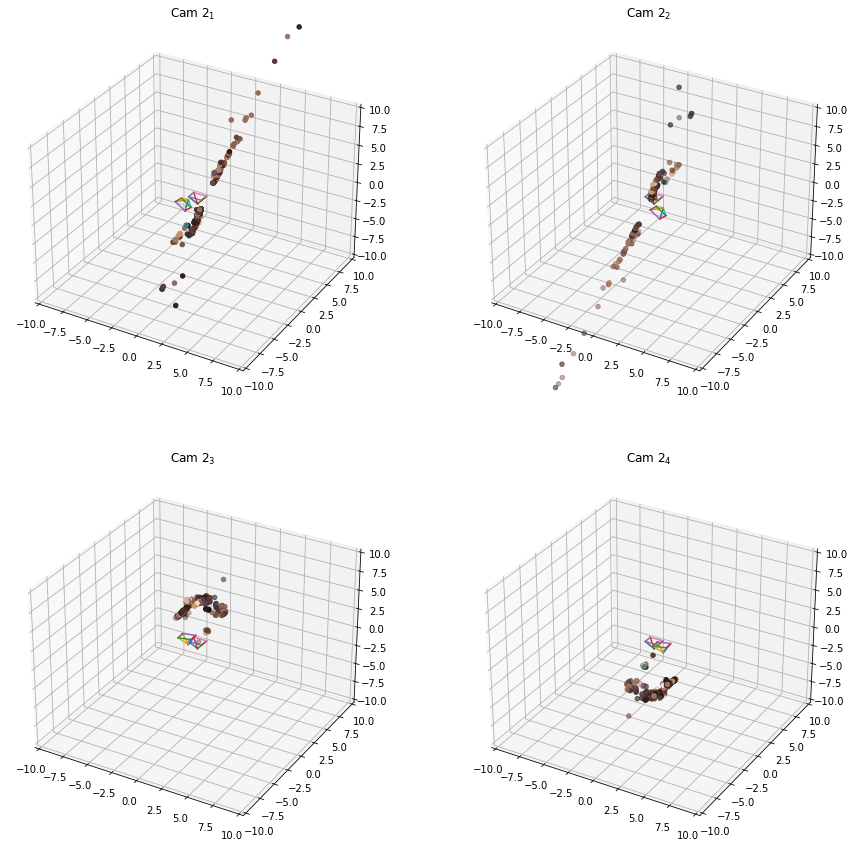

In [36]:
import utils
from utils import *

# A reconstructed point x will be in front of both cameras in one of these four solutions only

img1 = cv2.imread('./lab4_images/images/0001_s.png',cv2.IMREAD_UNCHANGED)


# Obtain the inlier points projective coordinates for Camera 1 and 2 
x1 = points1[:,indices_inlier_matches]
x2 = points2[:,indices_inlier_matches]

# Prepare figure 
fig = plt.figure(figsize=(15,15))
axs = [fig.add_subplot(2,2,i+1, projection='3d') for i in range(4)]

# Variable for optimal camera
P2_selected = None

low_lim, up_lim = -10, 10
for i, ax, P2 in zip(range(len(Pc2)), axs, Pc2):
    # Estimate by triangulization the 3D coordinates of the matches
    X_pred = triangulate(x1, x2, P1, P2, [w, h])
    X_eucl = homogeneous2euclidean(X_pred)
    
    # Render the 3D point cloud
    x_img = np.transpose(x1[:2]).astype(int)
    rgb_txt = (img1[x_img[:,1], x_img[:,0]])/255
    utils.draw_points(X_eucl.T, color=rgb_txt, ax=ax)
    utils.plot_camera(P1,w,h,1, ax=ax)
    utils.plot_camera(P2,w,h,1, ax=ax)
    ax.set_title(r"Cam $2_{%d}$" % (i+1))
    ax.set_xlim(low_lim, up_lim)
    ax.set_ylim(low_lim, up_lim)
    ax.set_zlim(low_lim, up_lim)
    # ax.view_init(0, 15)

    
    # Normalize x
    x = X_pred[:,1]
    x = x / x[3]
    
    # Select the best camera using some metric 
    x_hat_p1 = P1@x
    x_hat_p2 = P2@x
    
    # Source: https://stackoverflow.com/questions/9796077/determining-if-a-3d-point-is-in-front-of-a-pair-of-stereo-camera-given-their-es
    # Both camera predictions must be in front of the camera, looking toward the z direction. So, if predicted z is positive
    # for camera 1 => point in front of camera 1. Similar method to camera 2.
    
    if x_hat_p1[2] > 0 and x_hat_p2[2] > 0:
        print('Cam 2_%d selected' %(i+1))
        P2_selected = P2

# From now own P2 will be the camera you selected
P2 = P2_selected

In [37]:
# Estimate by triangulization the 3D coordinates of the matches
X_pred = triangulate(x1, x2, P1, P2, [w, h])
X_eucl = X_pred/X_pred[-1,:]
points3d = X_eucl[:3].T
fig = go.Figure(layout=dict(height=400, width=550))
points3d = X_eucl[:3].T
fig.add_trace(go.Scatter3d(x=points3d[:,0], y=points3d[:,1], z=points3d[:,2],mode='markers',name='3d points',marker=dict(size=2)))
fig.show()


Visualize Castle with COLMAP

In [38]:
images, cameras, points3D, keypoints, matches = read_model('lab4_images')

points3d_x = []
points3d_y = []
points3d_z = []
points3d_c = []
points3d_error = []

# For each 3D point create the scatter3D values
for value in points3D.values():
    points3d_x.append(value.xyz[0])
    points3d_y.append(value.xyz[1])
    points3d_z.append(value.xyz[2])
    points3d_c.append(len(value.image_ids))
    points3d_error.append(value.error)

fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=2
                                       ))])
fig.show()

Loaded 1 matches. 0/1 matches contained no data


## 2.7 Visualize the sparse reconstruction using the 2 images from lab 4, and the complete CASTLE dataset. Comment on the differences between techniques and number of images used. (1.0)
#### <span style='color:Green'> - Use the reconstruction from Colmap to the get the 3D points and visualize them following the same style, using two images and the complete dataset. </span>

In [39]:
images, cameras, points3D, keypoints, matches = read_model('lab4_images')

points3d_x = []
points3d_y = []
points3d_z = []
points3d_c = []
points3d_error = []

# For each 3D point create the scatter3D values
for value in points3D.values():
    points3d_x.append(value.xyz[0])
    points3d_y.append(value.xyz[1])
    points3d_z.append(value.xyz[2])
    points3d_c.append(len(value.image_ids))
    points3d_error.append(value.error)

fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=2
                                       ))])
fig.show()

Loaded 1 matches. 0/1 matches contained no data


In [40]:
images, cameras, points3D, keypoints, matches = read_model('castle_dense_large')

points3d_x = []
points3d_y = []
points3d_z = []
points3d_c = []
points3d_error = []

# For each 3D point create the scatter3D values
for value in points3D.values():
    points3d_x.append(value.xyz[0])
    points3d_y.append(value.xyz[1])
    points3d_z.append(value.xyz[2])
    points3d_c.append(len(value.image_ids))
    points3d_error.append(value.error)

fig = go.Figure(data=[go.Scatter3d(x=np.array(points3d_x), y=np.array(points3d_y), z=np.array(points3d_z),
                                   mode='markers', 
                                   marker=dict(
                                       size=1
                                       ))])
fig.show()

Loaded 0 matches. 0/0 matches contained no data
